In [1]:
import pytz
import plotly.express as px
import seaborn as sns
from datetime import datetime
from datetime import timezone
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import holidays
import darts
from darts.datasets import AirPassengersDataset
from darts.utils.statistics import check_seasonality, plot_acf, plot_residuals_analysis
from darts.metrics import mape, mase
from darts import TimeSeries
from darts.utils.timeseries_generation import datetime_attribute_timeseries
from darts.utils.timeseries_generation import holidays_timeseries

plt.style.use(['science','ieee', 'no-latex'])
# plt.rcParams.update({
#     "legend.fancybox": False,
#     "legend.frameon": False,
#     "text.usetex": True,
#     "font.family": "serif",
#     "font.serif": ["Times"],
#     "font.size":11})

# Calendar

In [2]:
# calendar60 = pd.read_csv("../../RDN/Load Data (2018-2019)/artifacts/time_60min.csv", index_col=0)
calendar15 = pd.read_csv("../../RDN/Load_Data/time_covariates_2009_2020.csv", index_col=0)

In [3]:
calendar15.head(3)
calendar15["year"] = calendar15["year"].astype(int)

c:\Ubuntu\Dev\Windows\I-NERGY\.venv\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
findfont: Font family ['serif'] not found. Falling back to DejaVu Sans.
findfont: Generic family 'serif' not found because none of the following families were found: Times
findfont: Font family ['serif'] not found. Falling back to DejaVu Sans.
findfont: Generic family 'serif' not found because none of the following families were found: Times
findfont: Font family ['serif'] not found. Falling back to DejaVu Sans.
findfont: Generic family 'serif' not found because none of the following families were found: Times


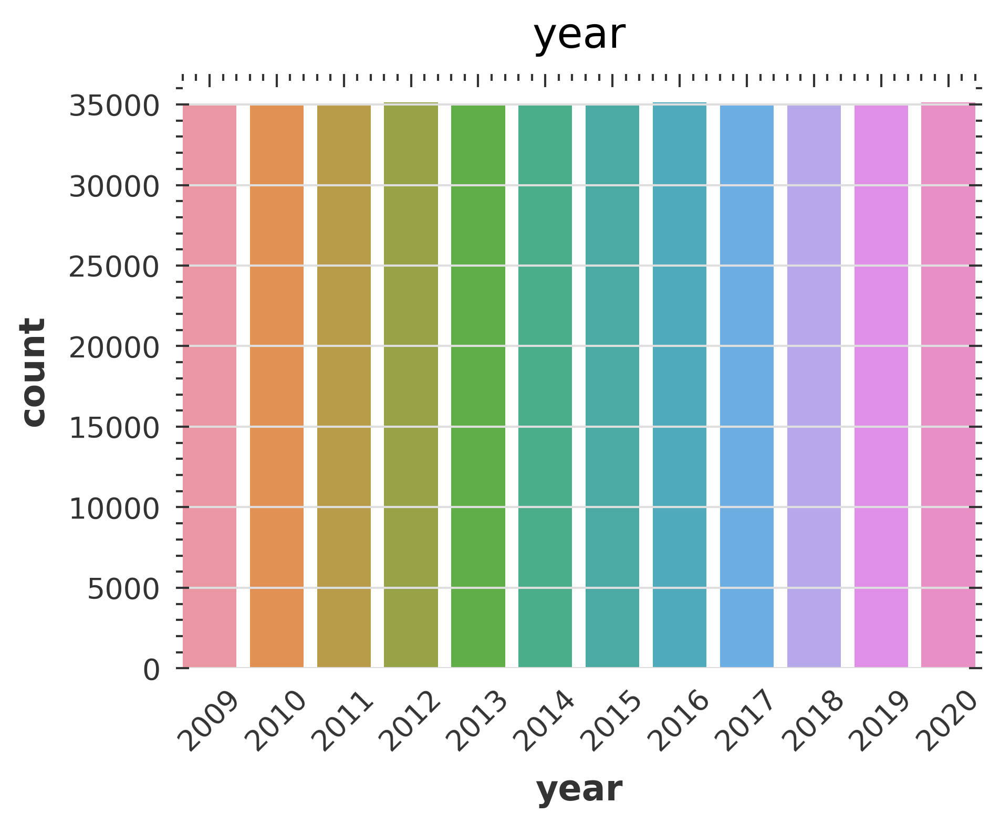

In [4]:
for col in ['year']:
    sns.countplot(calendar15[col])
    plt.title(col)
    plt.xticks(rotation=45)
    plt.show()


1. We have data for all the weekdays without almost equal counts which is expected.
2. Month data quantity is fluctuating according to fluctuation of number of days of each month (28, 30. 31)
3. The year distribution looks OK as we have equal data samples from 2018 and 2019.
4. Same thing for holidays.

# Timeseries (15 minute resolution)

In [5]:
ts = pd.read_csv(
    "../../RDN/Load_Data/2009-2021-global-load.csv", 
    index_col=0, 
    header=0,
    parse_dates=True)
ts = ts[~ts.index.duplicated(keep='first')]
ts = ts.asfreq('15min')
# ts_darts = TimeSeries.from_dataframe(ts, freq='15min')
# ts60_plus_time = pd.read_csv("../../RDN/Load Data (2018-2019)/artifacts/timeseries_plus_time_60min.csv", index_col=0)
ts_darts = TimeSeries.from_dataframe(ts)
ts.head()

,Load
Date,
2009-01-01 00:00:00,5363.894619
2009-01-01 00:15:00,5325.519064
2009-01-01 00:30:00,5252.920221
2009-01-01 00:45:00,5236.375564
2009-01-01 01:00:00,5155.823346


In [6]:
years_colors = zip(['2020', '2019', '2018', '2017'], [
                   'black', 'red', 'blue', 'green', ])


### PDF

C:\Users\spele\AppData\Local\Temp/ipykernel_54004/1102680893.py:3: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  ax = sns.histplot(x=ts[year]['Load'], color=color, label=year, kde=True)
C:\Users\spele\AppData\Local\Temp/ipykernel_54004/1102680893.py:3: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  ax = sns.histplot(x=ts[year]['Load'], color=color, label=year, kde=True)
C:\Users\spele\AppData\Local\Temp/ipykernel_54004/1102680893.py:3: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  ax = sns

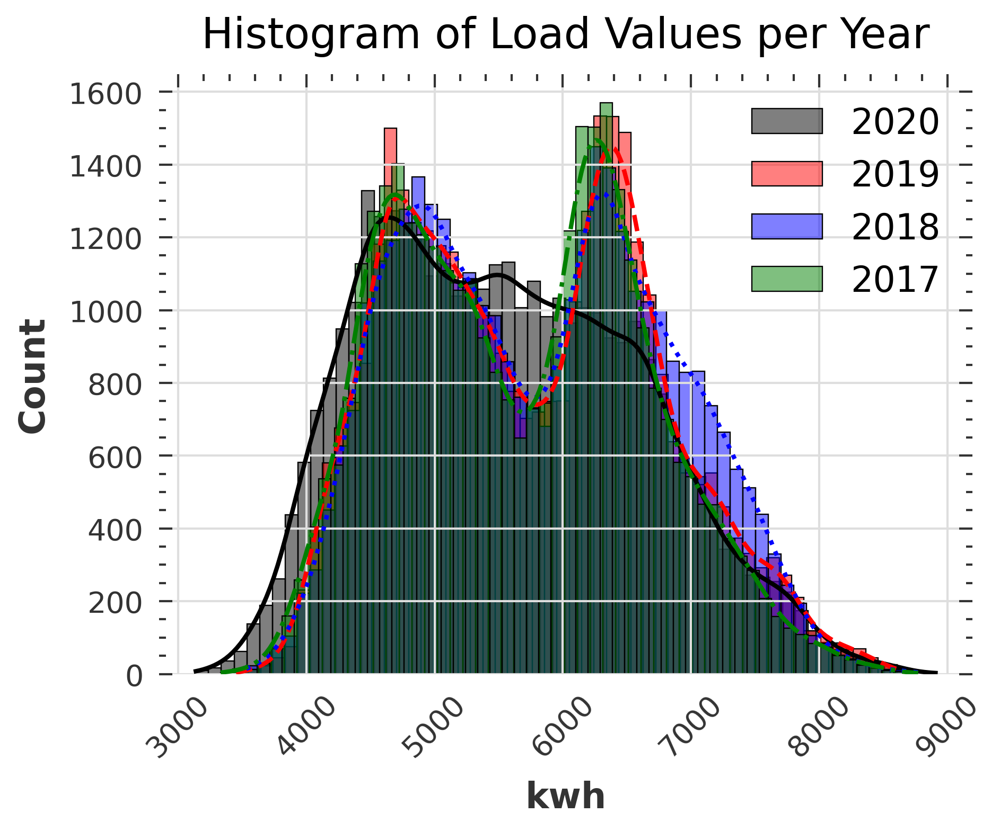

In [7]:
plt.figure()
for (year, color) in years_colors:
    ax = sns.histplot(x=ts[year]['Load'], color=color, label=year, kde=True)
    plt.xticks(rotation=45)
    ax.set(xlabel='kwh', title='Histogram of Load Values per Year')
    plt.grid()
    plt.legend()
plt.savefig("histograms.png")


### CDF

In [8]:
plt.figure()
for (year, color) in years_colors:
    ax = sns.histplot(x=ts[year]['Load'], color=color, label=year, kde=True, cumulative=True)
    plt.xticks(rotation=45)
    ax.set(xlabel='kwh', title='Histogram of load values (15 minute resolution)')
    plt.grid()
    plt.legend()
plt.savefig("histograms_cum.png")

<Figure size 1980x1500 with 0 Axes>

## Covariates

In [10]:
year = datetime_attribute_timeseries(
    time_index=ts_darts, attribute='year')

month = datetime_attribute_timeseries(
    time_index=ts_darts, attribute='month')

dayofyear = datetime_attribute_timeseries(
    time_index=ts_darts, attribute='dayofyear')

hour = datetime_attribute_timeseries(
    time_index=ts_darts, attribute='hour')    

# minute = datetime_attribute_timeseries(
#     time_index=series, attribute='minute', cyclic=True)

dayofweek = datetime_attribute_timeseries(
    time_index=ts_darts, attribute='dayofweek')

weekofyear = datetime_attribute_timeseries(
    time_index=ts_darts, attribute='weekofyear')

# dayofyear = datetime_attribute_timeseries(
#     time_index=series, attribute='dayofyear')

holidays = holidays_timeseries(
    time_index=ts_darts.time_index, country_code='PT')
        
time_covariates = year.stack(month) \
    .stack(dayofyear) \
    .stack(hour) \
    .stack(dayofweek) \
    .stack(weekofyear) \
    .stack(holidays)
    
time_covariates = time_covariates.with_columns_renamed(
    col_names=time_covariates.columns, 
    col_names_new=[
    "year", "month", "dayofyear", "hour", "dayofweek", "weekofyear", "holidays"])


In [11]:
fig = px.line(ts, title='Aggregated Load (kwh)')
fig.show()

# Average monthly loads

Load [kWh]:


C:\Users\spele\AppData\Local\Temp/ipykernel_54004/584514983.py:11: FutureWarning:

Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.

C:\Users\spele\AppData\Local\Temp/ipykernel_54004/584514983.py:18: FutureWarning:

Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.

C:\Users\spele\AppData\Local\Temp/ipykernel_54004/584514983.py:19: FutureWarning:

Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.

C:\Users\spele\AppData\Local\Temp/ipykernel_54004/584514983.py:20: FutureWarning:

Indexing a DataFrame with a datetimelike index using a single string to

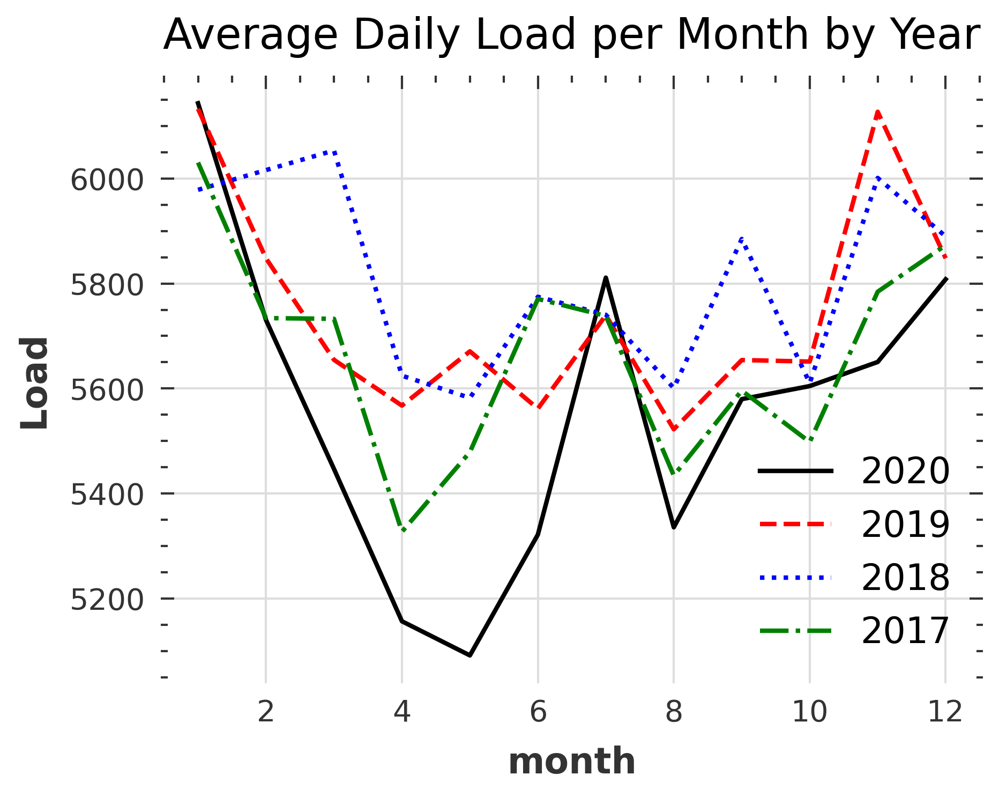

In [12]:
time_covariates_df = time_covariates.pd_dataframe()
ts_plus_time = pd.concat([ts, time_covariates_df], axis=1)
# ts_plus_time = TimeSeries.from_dataframe(ts).stack(time_covariates)
plt.figure()
# fig, axes = plt.subplots(1, 4)
print('Load [kWh]:')
# ts_plus_time['2020'].groupby('hour')['Load'].mean().plot(ax=axes[0], figsize=(25, 4))
# ts_plus_time['2020'].groupby('dayofweek')['Load'].mean().plot(ax=axes[1], figsize=(25, 3))
# ts_plus_time['2020'].groupby('month')['Load'].mean().plot(ax=axes[2], figsize=(25,  3))
# ts_plus_time['2020'].groupby('holidays')['Load'].mean().plot.bar(ax=axes[3], figsize=(25, 3))
ts_plus_time['2020'].groupby('month')['Load'].mean().plot(label='2020')
# plt.close()
# ts_plus_time.groupby('weekend')['Load'].mean().plot.bar(ax=axes[4], figsize=(25, 3))
# ts_plus_time['2019'].groupby('hour')['Load'].mean().plot(ax=axes[0], figsize=(25, 4))
# ts_plus_time['2019'].groupby('dayofweek')['Load'].mean().plot(ax=axes[1], figsize=(25, 3))
# ts_plus_time['2019'].groupby('month')['Load'].mean().plot(ax=axes[2], figsize=(25, 3))
# ts_plus_time['2019'].groupby('holidays')['Load'].mean().plot.bar(ax=axes[3], figsize=(25, 3))
ts_plus_time['2019'].groupby('month')['Load'].mean().plot(label='2019')
ts_plus_time['2018'].groupby('month')['Load'].mean().plot(label='2018')
ts_plus_time['2017'].groupby('month')['Load'].mean().plot(label='2017')
# ts_plus_time['2016'].groupby('month')['Load'].mean().plot(label='2016')
plt.ylabel("Load")
plt.title("Average Daily Load per Month by Year")
plt.legend()
plt.show()


# Average monthly profile for two covided months (3,4/2020)

<AxesSubplot:xlabel='dayofyear'>

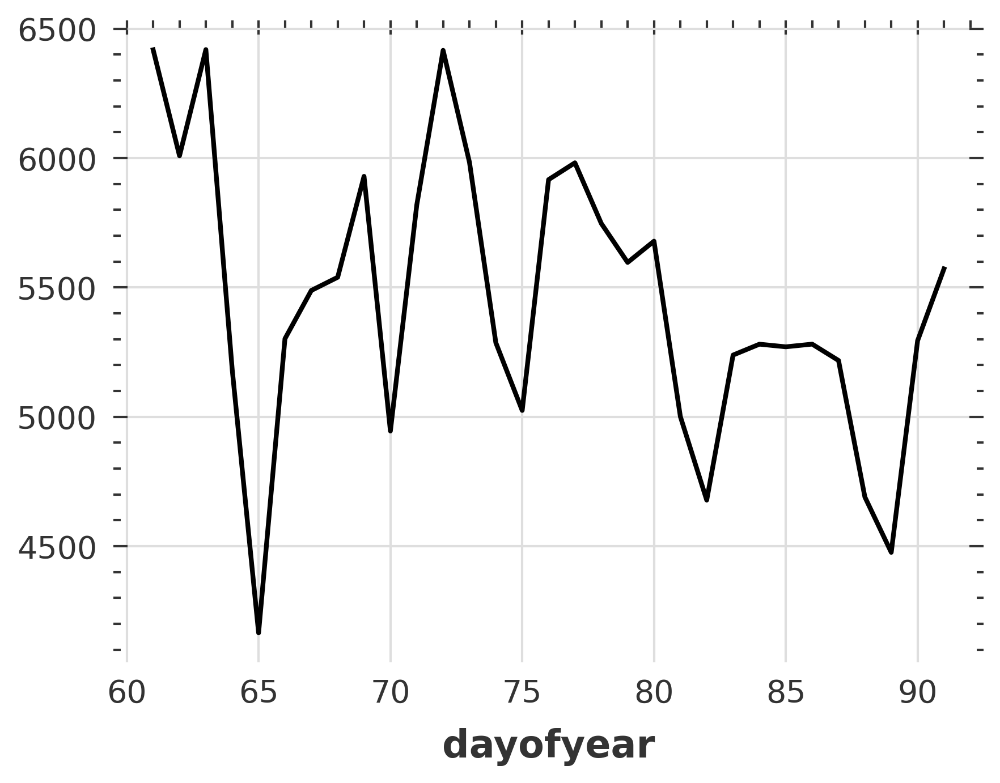

In [15]:
plt.figure()
# ts_plus_time['2020'].groupby('hour')['Load'].mean().plot(ax=axes[0], figsize=(25, 4))
# ts_plus_time['2020'].groupby('dayofweek')['Load'].mean().plot(ax=axes[1], figsize=(25, 3))
# ts_plus_time['2020'].groupby('month')['Load'].mean().plot(ax=axes[2], figsize=(25,  3))
# ts_plus_time['2020'].groupby('holidays')['Load'].mean().plot.bar(ax=axes[3], figsize=(25, 3))
ts_plus_time['20200301':'20200331'].groupby('dayofyear')['Load'].mean().plot(label='2020')
ts_plus_time['20190301':'20190331'].groupby('dayofyear')['Load'].mean().plot(label='2019')
ts_plus_time['20180301':'20180331'].groupby('dayofyear')['Load'].mean().plot(label='2018')
ts_plus_time['20170301':'20170331'].groupby('dayofyear')['Load'].mean().plot(label='2017')
plt.xlabel()
plt.title("Average Daily Profile for March")


**Observations: **
1. Load peaks are observed mainly during the afternoon until 21.00
2. Working days exhibit the highest of loads
3. The total loads are much higher during the winter monts. May and June have the lowest mean value (probably due to the abscence of both cooling and heating loads)
4. Holidays weekends and working days clearly lead to reduction of the mean values of the total load

# Initial Time Series Analysis - Darts and statsmodels
## ACF / PACF

In [ ]:
series = TimeSeries.from_dataframe(ts60)
series

NameError: name 'ts60' is not defined

In [ ]:
import statsmodels.api as sm
fig, ax = plt.subplots(2,1, figsize=(15, 8))
fig = sm.graphics.tsa.plot_acf(ts60['Load'], lags=24*10, ax=ax[0])
fig = sm.graphics.tsa.plot_pacf(ts60['Load'], lags=24*10, ax=ax[1])
plt.show()


Both plots demonstrate the need for both daily and weekly AR (PACF) and MA (ACF) terms.

## Seasonality checks with darts

In [ ]:
for m in range(2, 366*24):
    is_seasonal, period = check_seasonality(series, m=m, alpha=.05, max_lag=500*24)
    if is_seasonal:
        print('There is seasonality of order {}.'.format(period))

### Example decomposition to capture daily seasonalities

In [ ]:
from statsmodels.tsa.seasonal import seasonal_decompose
result = seasonal_decompose(ts60['Load'],  model='additive', period=24)
f = result.plot()0
f.set_figheight(15)
f.set_figwidth(25)
plt.show()

This decomposition plots are not sufficient as we expect seasonal patterns of daily (24 timesteps), weekly (7x24 timesteps) and yearly (365x24 timesteps) periods. The rest of the analysis will take place in the R notebook. R_rdn_time_series_analysis.ipynb

In [ ]:
result.resid.head(100)

In [ ]:
daily_deaseasonalized = ts60['Load'] - result.seasonal
result2 = seasonal_decompose(daily_deaseasonalized,  model='additive', period=24*7)
f = result.plot()
f.set_figheight(15)
f.set_figwidth(25)
plt.show()

In [ ]:
result.seasonal.to_csv('../../RDN/Load Data (2018-2019)/artifacts/decomposition/rdn_daily_seasonality.csv')
result.observed.to_csv('../../RDN/Load Data (2018-2019)/artifacts/decomposition/rdn_observed.csv')
result2.seasonal.to_csv('../../RDN/Load Data (2018-2019)/artifacts/decomposition/rdn_weekly_seasonality.csv')
result2.trend.to_csv('../../RDN/Load Data (2018-2019)/artifacts/decomposition/rdn_trend.csv')
result2.resid.to_csv('../../RDN/Load Data (2018-2019)/artifacts/decomposition/rdn_resid.csv')